# Quantitative methods for logistics: Heuristics

*Mark Duinkerken, Bilge Atasoy*

Guest lecture by: *Breno Beirigo*

## Learning goals

- Understand the principles of heuristics.
- Explain the following 4 types in relation to optimization problems:
  - Local search
  - Tabu search
  - Simulated annealing
  - Genetic algorithms

Click [here](https://1drv.ms/p/s!AuEYB6vlajI42uUGY5zuLWSPDMirhA?e=dTRGfu) to access the support slides.



Setting up the resources used throughout the document:

In [1]:
# Meausure elapsed time
import time

# Scripts for this lecture
import static, animated, util, heuristic, metaheuristic, complexity

# Display
from pprint import pprint
import matplotlib.pyplot as plt
from IPython.display import set_matplotlib_formats
%matplotlib inline
set_matplotlib_formats('svg')
import seaborn as sns
sns.set_style("whitegrid")

# Math
import itertools
import math
import numpy as np

# Fixed seed to for repeatibility
np.random.seed(7)

/tmp/ipykernel_417/3047519410.py:12: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg')


## Introduction

Exact optimization methods generally cannot find the optimal solution of high-dimensional in reasonable time.

This way, sulutions for *combinatorial optimization problems* (COPs) such as the *traveling salesman problem* (TSP) and the *vehicle routing problem* (VRP) cannot be determined for realistic instance sizes.

### On the complexity of combinatorial optimization problems (COPs)

*Combinatorial optimization problems* (COPs) are a class of optimization problems with discrete decision variables and a finite search space, although still too large for an exhaustive search to be a realistic option (Korte, Vygen, Korte, & Vygen, 2012). Many real-life problems (e.g., vehicle routing problem, scheduling problem, etc.) can be formulated as COPs.

The formal representation of a COP is as follows:

$$
\text{Minimize} \; c(x) \\
\text{subject to:} \\g(x) \geq b \\ x \geq 0, x \in f
$$

where the inequalities $g(x) \geq 0$ and $x \geq 0$  are the constraints that specify a convex polytope over which the objective function $c(x)$ is to be minimized, and  $f$ is the finite set of feasible solutions that satisfy the constraints.

A large part of COPs belong to the NP-Hard class of optimization problems, which require exponential time to be solved to optimality (Talbi, 2009).

#### A vehicle routing problem study case

> How many ways can $k$ vehicles pick up $n$ customers?

Let us assume customers 1, 2, 3, and 4 (i.e., $n=4$) must picked picked up by vehicles 1, 2, and 3 (i.e., $k=3$):

| Vehicle 1 | Vehicle 2 | Vehicle 3 | Way                                                                                   | Representation      |
|:---------:|:---------:|:--------: |---------------------------------------------------------------------------------------|---------------------|
| 🧍 🧍 🧍 🧍 |           |           | Customers 1,2,3, and 4 picked up by Vehicle 1                                         | `((1,2,3,4),(),())` |
|   🧍 🧍 🧍 |     🧍     |           | Customers 1,2, and 3 picked up by Vehicle 1 and customer 4 picked up by Vehicle 2     | `((1,2,3),(4),())`  |
|    🧍 🧍   |    🧍 🧍   |           | Customers 1 and 2 picked up by vehicle 1 and customers 3 and 4 picked up by Vehicle 2 | `((1,2),(3,4),())`  |

Using the [stars and bars](https://en.wikipedia.org/wiki/Stars_and_bars_(combinatorics)) method, the solutions presented above could be represented as:

- 🧍🧍🧍🧍┃┃
- 🧍🧍🧍┃🧍┃
- 🧍🧍┃🧍🧍┃

The bars "┃" mark the separation between customers being serviced by different vehicles. Notice that one fewer bar is used since there is no need to service more customers after the last user.

The number of ways to distribute customers to vehicles correspond to the number of ways symbols '🧍🧍🧍🧍┃┃' can be combined.
With 7 symbols, we must choose 2 of them to be customer separators. Thus:

There are ${6 \choose 2} = 15$ ways to distribute $4$ customers to $3$ vehicles (or, alternatively, 15 ways of choosing 2 symbols among 6 to be separators).

The ways are as follows:

In [2]:
n = 4 # n. of customers
k = 3 # n. of vehicles
customers = ['🧍'] * n
separations = ["┃"] * (k - 1) # 3 vehicles = 2 separations
symbols = customers + separations

# Transformation to set exclude duplicate permutations
ways = set(itertools.permutations(symbols))


print(f"k={4} vehicles can pick up n={n} customers in {len(ways)} different ways.\n")
print("# Ways (vehicles are separated by '|'):")
complexity.enumerate_ways(ways)

k=4 vehicles can pick up n=4 customers in 15 different ways.

# Ways (vehicles are separated by '|'):
  1  ┃┃🧍🧍🧍🧍
  2  ┃🧍┃🧍🧍🧍
  3  ┃🧍🧍┃🧍🧍
  4  ┃🧍🧍🧍┃🧍
  5  ┃🧍🧍🧍🧍┃
  6  🧍┃┃🧍🧍🧍
  7  🧍┃🧍┃🧍🧍
  8  🧍┃🧍🧍┃🧍
  9  🧍┃🧍🧍🧍┃
 10  🧍🧍┃┃🧍🧍
 11  🧍🧍┃🧍┃🧍
 12  🧍🧍┃🧍🧍┃
 13  🧍🧍🧍┃┃🧍
 14  🧍🧍🧍┃🧍┃
 15  🧍🧍🧍🧍┃┃


The number of ways is given by the formula:

$${n + k - 1 \choose k - 1} = \frac{(n + k - 1)!}{(k-1)!(n+k-1-(k-1)!} = \frac{(n + k - 1)!}{(k-1)!n!},$$

which can be applied using the `comb` function:

In [3]:
from scipy.special import comb
n_ways = int(comb(n+k-1,k-1))
print(f"k={k} vehicles can pick up n={n} customers in {n_ways} different ways.")

k=3 vehicles can pick up n=4 customers in 15 different ways.


Knowing how many ways customers can be assigned to vehicles, we can also calculate the total number of possible assignments, that is:

> In how many ways $k$ vehicles can pick up $n$ customers?

Similarly to the TSP (a one-vehicle VRP) $n$ customers can be visited in $n!$ ways.
Each possible customer permutation can be further divided into ${n + k - 1 \choose k - 1}$ ways using the '┃' separators.

For example, the sequence of visits `(1,2,3,4)` can be split among 3 vehicles as follows:

In [4]:
ways_1234 = complexity.get_ways_to_split_list_in_kbins((1,2,3,4), 3)
complexity.enumerate_ways(ways_1234)

  1  1234┃┃
  2  123┃4┃
  3  123┃┃4
  4  12┃34┃
  5  12┃3┃4
  6  12┃┃34
  7  1┃234┃
  8  1┃23┃4
  9  1┃2┃34
 10  1┃┃234
 11  ┃1234┃
 12  ┃123┃4
 13  ┃12┃34
 14  ┃1┃234
 15  ┃┃1234


Therefore, $k=3$ vehicles can pickup $n=4$ customers in $4!{6 \choose 2} =  12 \times 15 = 360$ ways.

the total number of schedules is given by the formula:

$$n!{n + k - 1 \choose k - 1} = n! \frac{(n + k - 1)!}{(k-1)!n!} = \frac{(n + k - 1)!}{(k-1)!}$$    

##### Sulution space


Below, the solution space (total number of possible schedules) for different combinations of number of customers and number of vehicles:

In [5]:
import pandas as pd
from scipy.special import comb
from decimal import Decimal

k_list = [3, 5, 10]
n_list = [5, 25, 50, 100]
nk_dict = []
for n,k in itertools.product(n_list, k_list):
    nk_schedules = math.factorial(n+k-1)/math.factorial(k-1)
    if nk_schedules < 10**37: # Show zeros for "smaller" values
        nk_dict.append((n, k, f"{int(nk_schedules):,}"))
    else: # Show scientific notation
        nk_dict.append((n, k, f"{Decimal(nk_schedules):.2E}"))

cols = [
        "N. of customers (n)",
        "N. of vehicles (k)",
        "N. of vehicle-customer schedules"]

pd.DataFrame(nk_dict, columns=cols).set_index(cols[0], cols[1])

,N. of vehicles (k),N. of vehicle-customer schedules
N. of customers (n),,
5,3,"2,520"
5,5,"15,120"
5,10,"240,240"
25,3,"5,444,434,725,209,175,970,119,942,144"
25,5,"368,406,749,739,154,269,232,085,073,920"
25,10,"813,582,448,852,524,689,603,239,037,894,656"
50,3,4.03E+67
50,5,9.62E+69
50,10,3.82E+74


Typically, exact algorithms can solve to optimality relatively small instances involving around 100 customers.

For $n=100$ customers and $k=3$ vehicles there are about $4.8\times 10^{161}$ possible schedules. For the sake of comparison, there are between $10^{78}$ and $10^{82}$ atoms in the observable universe [[↗]](https://www.universetoday.com/36302/atoms-in-the-universe/)!

##### A brute force approach: Exhaustive search

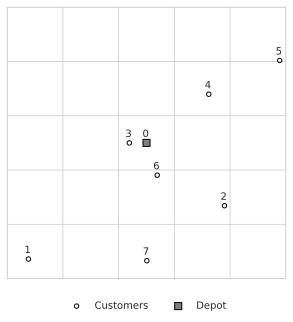

In [6]:
n_vehicles = 3
n_customers = 7

# Get a random distribution of nodes
coords = util.get_random_nodes(n_customers)
nodes = list(range(len(coords)))

# Depot = first node / Customers = remaining nodes 
depot, customer_nodes = nodes[0], nodes[1:]

# Plot nodes
figsize = (5, 5)
static.draw_nodes(coords, nodes, figsize=figsize)

In [7]:
# Get all possible routes
vrp_solutions = heuristic.get_brute_force(
    customer_nodes,
    depot=depot,
    n_vehicles=n_vehicles)

# Calculate route costs
vrp_sol_costs = [util.get_total_cost(s, coords) for s in vrp_solutions]

# Plot
plt.scatter(np.arange(len(vrp_sol_costs)), vrp_sol_costs, s=1, alpha=0.5)
plt.title(
    f"Costs for all {len(vrp_solutions):,} solutions for "
    f"\n a {n_customers}-customer and {n_vehicles}-vehicle VRP")
 
plt.ylabel("Solution cost")
_ = plt.xlabel("Solution")

The sulutions assume vehicles are *distinguishable*, for example, if $k=3$ and $n=4$, the following routes are different:
- `((), (0, 1, 0), (0, 2, 3, 4, 0))`,
- `((), (0, 2, 3, 4, 0), (0, 1, 0))`,
- `((0, 1, 0), (0, 2, 3, 4, 0), ())`,
- `((0, 1, 0), (), (0, 2, 3, 4, 0))`,
- `((0, 2, 3, 4, 0), (), (0, 1, 0))`, and
- `((0, 2, 3, 4, 0), (0, 1, 0), ())`.

Format: (`route_V1`, `route_V2`, `route_V3`).

If vehicles are *undistinguishable* we have:

In [8]:
vrp_solutions_undistinguishable = heuristic.get_brute_force(
    customer_nodes,
    depot=depot,
    n_vehicles=n_vehicles,
    distinguish_vehicles=False)

print(f"{n_customers}-customer/{n_vehicles}-vehicle "
      f"VRP solutions (undistinguishable vehicles) = "
      f"{len(vrp_solutions_undistinguishable):,}")

7-customer/3-vehicle VRP solutions (undistinguishable vehicles) = 32,760


In [9]:
vrp_sorted_sol = sorted(
    vrp_solutions_undistinguishable,
    key=lambda s:util.get_total_cost(s, coords),
    reverse=True)

animated.show_solutions(vrp_sorted_sol[-100:], coords, nodes)

##### Questions

- How the solution space changes if *time window* and *capacity* constraints are considered (i.e., CVRP, VRPTW)?
- How the solution space changes if we consider customer *pickups and deliveries* (i.e., VRPPD)?


### Heuristics for COPs

*Heuristic algorithms* are commonly used approximate methods to search for COP solutions.
They tradeoff optimality for competitive performance, allowing decision-makers to quickly find good feasible solutions using less computational effort.

Heuristics can be  furter divided into *problem-specific heuristics* and *metaheuristics*.
Below, a summary *of* classical optimization methods.



![classical optimization methods](https://drive.google.com/uc?export=view&id=1zddUJmItn_-vN_VG3351M2aGgcebJ-fs)

Classical optimization methods (Talbi, 2009).



### Problem-dependent heuristics

A *heuristic* is a procedure that is likely to discover a very good feasible solution, but not necessarily an optimal solution, for the specific problem being considered.
No guarantee can be given about the quality of the solution obtained, but a well-designed heuristic method usually can provide a solution that is at least nearly optimal.
The procedure also should be sufficiently efficient to deal with very large problems.

Heuristic methods tend to be ad hoc in nature: they are carefully tailored to fit a specific problem type rather than a variety of ­application.
The procedure often is a full-fledged iterative algorithm, where each iteration involves conducting a search for a new solution that might be better than the best solution found previously.
When the algorithm is terminated after a reasonable time, the solution it provides is the best one that was found during any iteration.



### Metaheuristics

A *Metaheuristic (MH)* is a general solution method that provides both a general structure and strategy guidelines for developing a specific heuristic method to fit a particular kind of problem.
Similarly to heuristics, they do not guarantee optimality, but are effective to find reasonable good solutions in different applications.

However, unlike classical or deterministic methods, MHs are not much affected by the structure of the problem: they try to improve the solution set based on the experience or on a "trial and error" approach using defined components (often stochastic) throughout the process (de Armas et al., 2021).

>A metaheuristic is a general kind of solution method that orchestrates the interaction between local improvement procedures and higher level strategies to create a process that is capable of escaping from local optima and performing a robust search of a feasible region.

Other authors emphasize the flexible nature of MHs. For example, the method has been defined as:

>"a high-level problem-independent algorithmic framework that provides a set of guidelines or strategies to develop heuristic optimization algorithms." — Sorensen and Glover (2013)


>an iterative master process that guides and modifies the operations of subordinate heuristics to efficiently produce high-quality solutions.
>It may manipulate a complete (or incomplete) single solution or a collection of solutions at each iteration.
>The subordinate heuristics may be high (or low) level procedures, or a simple local search, or just a construction method." — Voß et al. 1999

Typically, MHs start with randomly or pseudo-randomly generated feasible solutions and update them by conducting systematic changes by means of a given solution structure or in a sampling fashion (J. de Armas et al., 2021).



#### Classification criteria



##### Nature versus non-nature inspired

- **Nature inspired**: By natural processes (biology), for example:

  - *Genetic Algorithm* (GA) (Holland et al., 1992),
  - *Memetic Algorithm* (MA) (Moscato et al., 1989), and
  - *Differential Evolution* (DE) (Storn & Price, 1997),

  Swarm intelligence algorithms, such as:

  - *Artificial Bee Colony* (ABC) (Karaboga, 2005),
  - *Ant Colony Optimization* (ACO) (Dorigo & Blum, 2005), and
  - *Particle Swarm Optimization* (PSO) (Kennedy, 2006).

- **Non-nature inspired**: For example:

  - *Imperialist Competitive Algorithm* (ICA) (Atashpaz-Gargari & Lucas, 2007) (society),
  - *Simulated Annealing* (SA) (Kirkpatrick, Gelatt, & Vecchi, 1983) (physics), and
  - *Harmony Search* (HS) (Geem, Kim, & Loganathan, 2001) (musics).

##### Memoryless versus with memory

- **Memoryless**: do not use the historical information dynamically during the search process (e.g., GA , SA)

- **With memory**: memorize historical information during the search process, and this memory helps to avoid making repetitive decisions (e.g., *Tabu Search* (TS) by Glover & Laguna, 1998).



##### Deterministic versus stochastic

- **Deterministic**: always obtain the same final solution when starting from the same initial solution (e.g., TS).

- **Stochastic**: apply random rules to solve the problem and obtain different final solutions when starting from the same initial solution (e.g., SA, GA).



##### Starting point: sigle-solution versus population based

- **Single-solution based**: also known as trajectory methods, manipulate and transform a single solution to reach the (near-) optimal solution. Examples:

  - *Tabu Search* (TS),
  - *Simulated Annealing* (SA),
  - *Iterated Local Search* (ILS) (Lourenço, Martin, & Stützle, 2003),
  - *Breakout Local Search* (BLS) (Benlic, Epitropakis, & Burke, 2017),
  - *Descent-based Local Search* (DLS) (Zhou, Hao, & Du- val, 2016),
  - *Guided Local Search* (GLS) (Voudouris & Tsang, 1999),
  - *Variable Neighborhood Search* (VNS) (Mladenovic & Hansen, 1997),
  - *Hill Climbing* (HC) (Johnson, Papadimitriou, & Yannakakis, 1988),
  - *Large Neighborhood Search* (LNS) (Shaw, 1998), and
  - *Great Deluge* (GD) (Dueck, 1993).

- **Population-based**: try to find the optimal solution by evolving a population of solutions. For example, GA, PSO, ACO, and *Water Wave Optimization* (WWO) (Zheng, 2015).

Single-solution based MHs are more *exploitation* search algorithms, having the power to intensify the search in local regions, whereas population-based MHs are more *exploration* algorithms, allowing a better diversification in the entire search space.



##### Search mechanism: iterative versus greedy

- **Iterative**: starts with a complete solution and manipulates it at each iteration using a set of search operators (e.g., ILS, GA).

- **Greedy**: Also called constructive algorithm, starts from an empty solution and constructs the solution step by step until a complete solution is obtained. Examples:

  - *Nearest Neighbor* (NN),
  - *Greedy Heuristic* (GH),
  - *Greedy Randomized Heuristic* (GRH), and
  - *Greedy Randomized Adaptive Search Procedure* (GRASP) (Feo & Resende, 1995).



### Hybridization

Hybrid algorithms that combine different MHs can sometimes perform better than an algorithm that is based solely on a single MH: experienced practitioners occasionally will select strategies from different MHs when designing their heuristic methods.



#### Implementation challenges



##### Algorithm selection

There is no single MH that dominates all other MHs in solving all problem instances. Instead, different MHs perform well on different problem instances (i.e., performance complementarity phenomena) ( Kerschke et al., 2019 ).
Therefore, there is always an unsolved question as

>*"Which algorithm is likely to perform best for a given COP?"* (Rice et al., 1976).

The ideal way to find the best algorithm to solve a COP, when the computational resources are unlimited, is to exhaustively run all available algorithms and choose the best solution, no matter by which algorithm it has been obtained.

However, since it is practically impossible to test all available algorithms on a particular problem instance due to limited computational resources, research efforts have been focused instead of the question:

>"Among the existing algorithms, how to select the most appropriate one for solving a particular problem instance?"



##### Fitness evaluation

Fitness evaluation is one of the key components of MHs to guide the search process towards the promising regions of the search space.
For some optimization problems, there is no analytical fitness function by which the solutions are evaluated, or even if it exists, it is computationally expensive to evaluate.



##### Initialization strategies

The way of initializing a MH has a profound impact on its exploration and exploitation abilities. If the initial solutions are not well diversified, a premature convergence may occur, and the MH gets stuck in local optima. On the other hand, starting from low quality solutions may take a larger number of iterations to converge. There are three strategies for initializing MHs:

- **Random**: an initial solution is generated randomly, regardless of the quality of the solution.
- **Greedy**: a solution is initialized with a good-enough quality.
- **Hybrid**: combines random and greedy strategies.

## Solving the traveling salesman problem (TSP)

### Study cases

In the following, we present two study cases:

- Random city distribution: you can set the number of nodes that will be spread randomly in a [0,1]x[0,1] plane.
- 48 US capitals: a classic TSP instance comprised of the 48 US capitals with minimal tour length 33,523. You can find more classic TSP instances [here](https://people.sc.fsu.edu/~jburkardt/datasets/tsp/tsp.html).


#### Random city distribution

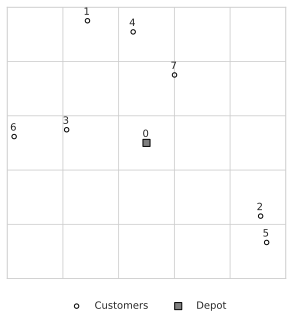

In [10]:
n_customers = 7
figsize = (5, 5)

coords = util.get_random_nodes(n_customers)
nodes = list(range(len(coords)))
depot, customer_nodes = nodes[0], nodes[1:]

static.draw_nodes(coords, nodes, figsize=figsize)

#### 48 US capitals

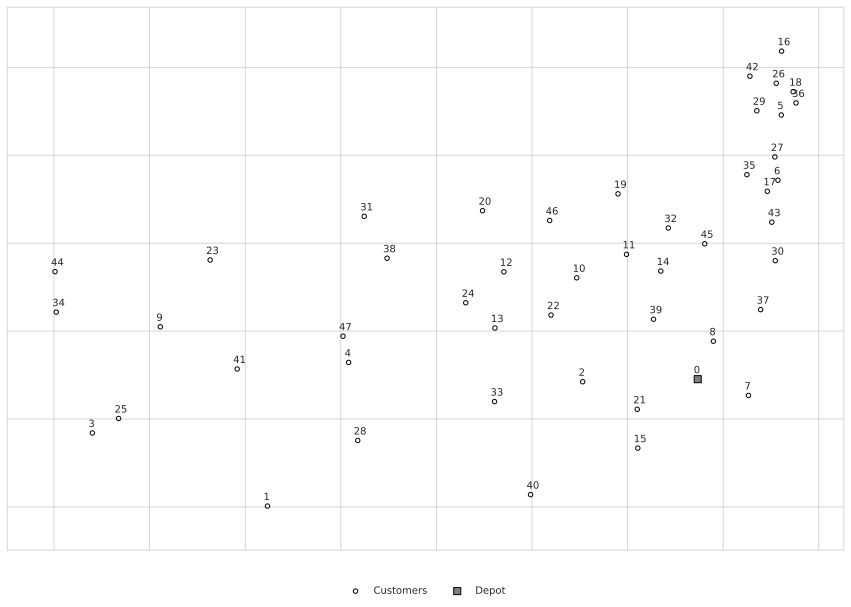

In [11]:
us_nodes, us_coords = static.get_data_us_capitals()
us_depot, us_customer_nodes = us_nodes[0], us_nodes[1:]
us_fig, us_ax = static.get_us_plot()
static.draw_nodes(us_coords, us_nodes, ax=us_ax)

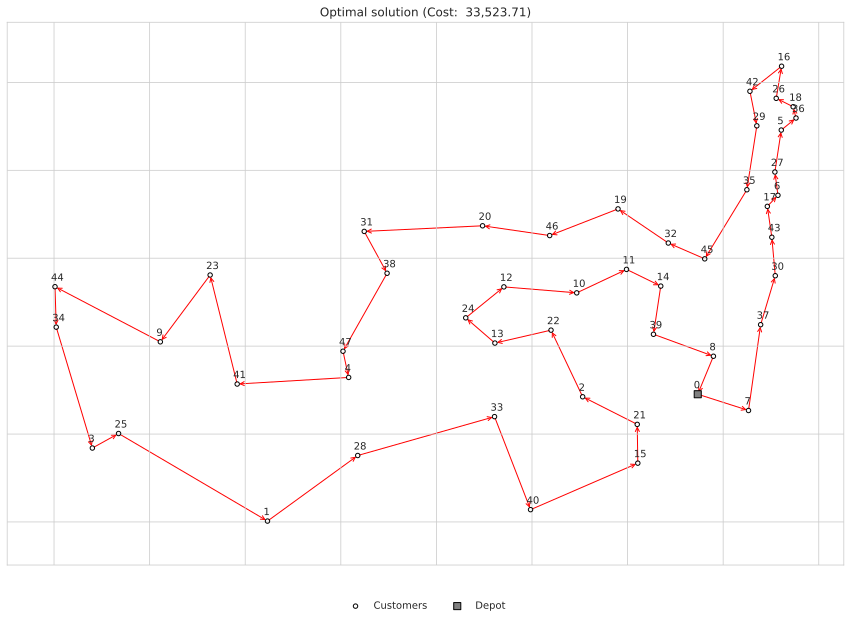

In [12]:
# Optimal solution
us_min_tour = [0, 7, 37, 30, 43, 17, 6, 27, 5, 36, 18, 26, 16, 42, 29, 35, 45, 32, 19, 46, 20, 31, 38, 47, 4, 41, 23, 9, 44, 34, 3, 25, 1, 28, 33, 40, 15, 21, 2, 22, 13, 24, 12, 10, 11, 14, 39, 8, 0]
us_fig, us_ax = static.get_us_plot()
_ = static.construct_route(us_min_tour, us_nodes, us_coords, fig=us_fig, ax=us_ax, label="Optimal solution")

In [13]:
a = '''1
8
38
31
44
18
7
28
6
37
19
27
17
43
30
36
46
33
20
47
21
32
39
48
5
42
24
10
45
35
4
26
2
29
34
41
16
22
3
23
14
25
13
11
12
15
40
9
1'''

b = [i -1 for i in map(int,a.split("\n"))]
print(b)

[0, 7, 37, 30, 43, 17, 6, 27, 5, 36, 18, 26, 16, 42, 29, 35, 45, 32, 19, 46, 20, 31, 38, 47, 4, 41, 23, 9, 44, 34, 3, 25, 1, 28, 33, 40, 15, 21, 2, 22, 13, 24, 12, 10, 11, 14, 39, 8, 0]


### A brute force approach: Exhaustive search

Check all possible routes (n customers = n! solutions):

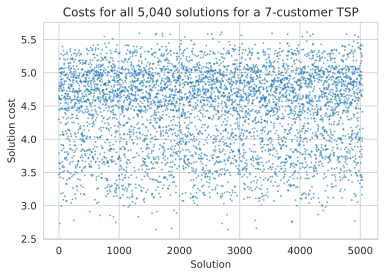

In [14]:
tsp_solutions = heuristic.get_brute_force(customer_nodes, depot=depot)
tsp_sol_costs = [util.get_total_cost(s, coords) for s in tsp_solutions]

plt.scatter(np.arange(len(tsp_solutions)), tsp_sol_costs, s=1, alpha=0.5)
plt.title(f"Costs for all {len(tsp_solutions):,} solutions for a {n_customers}-customer TSP") 
plt.ylabel("Solution cost")
_ = plt.xlabel("Solution")

The best 50 solutions:

In [15]:
tsp_sorted_sol = sorted(tsp_solutions, key=lambda s:util.get_total_cost(s, coords), reverse=True)
animated.show_solutions(tsp_sorted_sol[-50:], coords, nodes, figsize=figsize)

### Construction heuristics

#### Random

Route: (0, 4, 6, 3, 5, 7, 2, 1, 0)


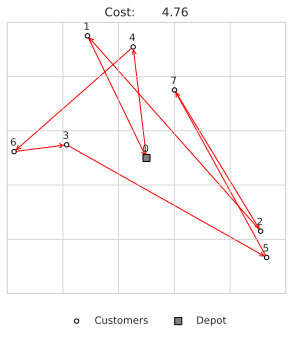

In [16]:
random_route = (0,) + tuple(np.random.permutation(np.arange(n_customers)+1)) +  (0,)
print(f"Route: {random_route}")
_ = static.construct_route(random_route, nodes, coords, figsize=figsize)

#### Nearest Neighbor
Randomly select a starting node and until no more node is available add the closest node to the last selected node. Finally, connect the last node with the first node.

Starting from: 5 - Route: (0, 7, 4, 1, 3, 6, 5, 2, 0)


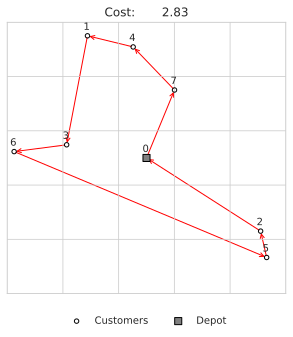

In [17]:
random_start = np.random.randint(len(nodes))
nn_route = heuristic.get_route_nearest_neighborhood(customer_nodes, coords, start=random_start)
print(f"Starting from: {random_start} - Route: {nn_route}")
_ = static.construct_route(nn_route, nodes, coords, figsize=figsize)

In [18]:
animated.construct_route(nn_route, coords, nodes, figsize=figsize)

#### Farthest addition

Starting from: 4 - Route: (0, 7, 2, 5, 4, 1, 6, 3, 0)


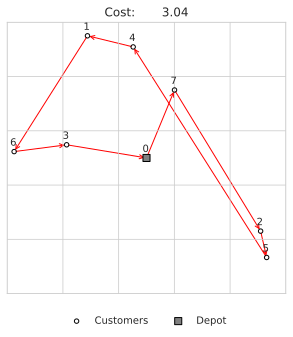

In [19]:
random_start = np.random.randint(len(nodes))
fa_route, sols = heuristic.get_route_farthest_addition(customer_nodes, coords, start=random_start)
print(f"Starting from: {random_start} - Route: {fa_route}")
fig_fa, ax_fa = static.construct_route(fa_route, nodes, coords, figsize=figsize)

Example of farthest insertion algorithm using the US capitals instance (48 nodes):

In [20]:
us_random_start = np.random.randint(len(us_nodes))
print(f"Starting from: {us_random_start}")

fa_us_route, fa_us_sol_steps = heuristic.get_route_farthest_addition(us_customer_nodes, us_coords, start=us_random_start)
print(f"Route: {fa_us_route}")

Starting from: 28
Route: (0, 8, 30, 6, 5, 36, 18, 26, 16, 28, 1, 25, 3, 34, 44, 9, 23, 41, 47, 4, 33, 40, 2, 39, 14, 10, 22, 13, 12, 24, 38, 31, 20, 46, 11, 32, 19, 42, 29, 27, 35, 17, 43, 45, 37, 7, 15, 21, 0)


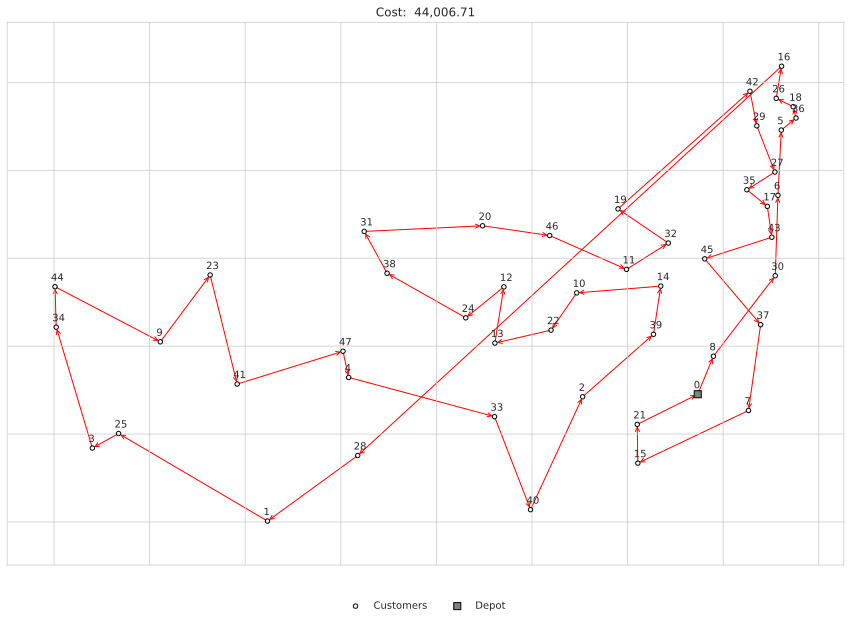

In [21]:
us_fig_fa, us_ax_fa = static.get_us_plot()
_ = static.construct_route(fa_us_route, us_nodes, us_coords, fig=us_fig_fa, ax=us_ax_fa)

In [22]:
us_fig, us_ax = static.get_us_plot()
animated.show_solutions(fa_us_sol_steps, us_coords, us_nodes, ax=us_ax, fig=us_fig)

### Local search

Local search algorithms (a.k.a., greedy heuristics) aim at iteratively moving to higher quality solutions in the neighborhood until no further improvement can be made. More formally:

> At iteration $k$, the search moves from the current solution $X_k$ to a new solution $X_{k+1} \in N(X_k)$ (the neighborhood of $X_k$) only if the new point improves the value of the objective function $F(X)$.
If no better $X_{k+1}$ can be found in $N(X_k)$ or if a user-specified number of iterations is reached, stop searching.

Visiting the *immediate neighborhood* of $X_k$ requires less local search computation at the expense of solution quality.
Whereas visiting the *expanded neighborhood* may lead to better solution quality at the expense of increased computation costs.

#### Defining a neighborhood: 2-opt operator

The neighborhood for the 2-opt operator (a.k.a., 2-exchange or subtour reversal operator) is represented by all the permutations obtained by removing and reconnecting all pairs of edges (except for the adjacent ones).

For a TSP with $n$ nodes, the size of the neighborhood for the 2-opt operator is $\frac{n(n-1)}{2}-n$.

![2-opt example from Talbi 2009](https://drive.google.com/uc?export=view&id=1b-ZLI77sl8bzXoXwyz9GnMY1K1ciSLmf)

*Example of 2-opt (sub-tour reversal) for the TSP (Talbi, 2009)*

Let us apply the 2-opt algorithm in the solution constructed using the farthest addition heuristic:

(0, 7, 2, 5, 4, 1, 6, 3, 0)


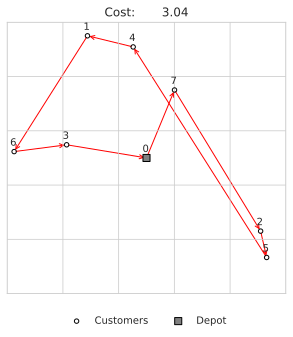

In [23]:
print(fa_route)
fig_fa

2-Opt route:

- Cost:   2.639 - Route: (0, 5, 2, 7, 4, 1, 6, 3, 0)


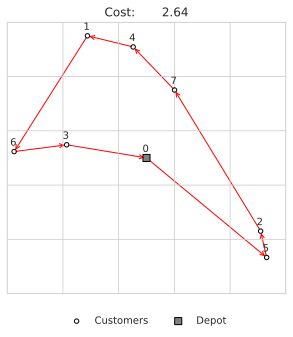

In [24]:
improved_fa_route = heuristic.get_route_2opt(fa_route, coords)
print(f"- Cost: {util.get_cost(improved_fa_route, coords):7.3f} "
      f"- Route: {improved_fa_route}")

_ = static.construct_route(improved_fa_route, nodes, coords, figsize=figsize)

Using the 2-OPT algorithm we can search the neighborhood of a solution until it can no longer be improved:

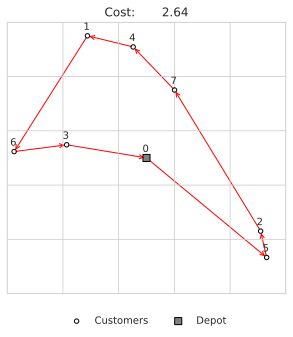

In [25]:
improved_ns_fa_route, improvement_history = heuristic.neighborhood_search_2opt(improved_fa_route, coords)
_ = static.construct_route(improved_ns_fa_route, nodes, coords, figsize=figsize)

# Farthest addition (FA) solution 
- Cost:   3.038 - Route: (0, 7, 2, 5, 4, 1, 6, 3, 0)
# 2-opt neighbor solution 
- Cost:   2.639 - Route: (0, 5, 2, 7, 4, 1, 6, 3, 0)
# Local search (using 2-opt) solution
- Cost:   2.639 - Route: (0, 5, 2, 7, 4, 1, 6, 3, 0)


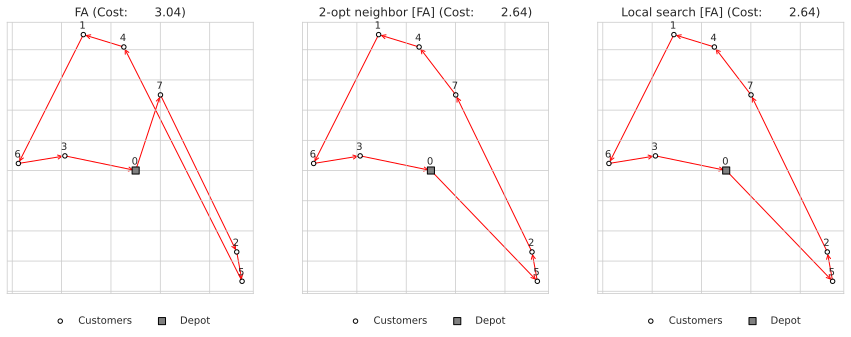

In [27]:
print("# Farthest addition (FA) solution \n"
      f"- Cost: {util.get_cost(fa_route, coords):7.3f} "
      f"- Route: {fa_route}")

improved_fa_route = heuristic.get_route_2opt(fa_route, coords)
print("# 2-opt neighbor solution \n"
      f"- Cost: {util.get_cost(improved_fa_route, coords):7.3f} "
      f"- Route: {improved_fa_route}")

improved_ls_fa_route, hist = heuristic.neighborhood_search_2opt(improved_fa_route, coords)
print("# Local search (using 2-opt) solution\n"
      f"- Cost: {util.get_cost(improved_ls_fa_route, coords):7.3f} "
      f"- Route: {improved_ls_fa_route}")

hist_route, hist_cost = zip(*hist)
fig, ax = plt.subplots(1,4, figsize=(20,5))
_ = static.construct_route(fa_route, nodes, coords, fig=fig, ax=ax[0], label="FA")
_ = static.construct_route(improved_fa_route, nodes, coords, fig=fig, ax=ax[1], label="2-opt neighbor [FA]")
_ = static.construct_route(improved_ls_fa_route, nodes, coords, fig=fig, ax=ax[2], label="Local search [FA]")
ax[3].plot(hist_cost)


Starting from a bad quality solution (e.g., random), many improvements can be made:

In [ ]:
# Starting solution
random_us_route = tuple([us_depot] + list(us_customer_nodes) + [us_depot])
improved_us_route = heuristic.neighborhood_search_2opt(random_us_route, us_coords)

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(16,5))
_ = static.construct_route(random_us_route, us_nodes, us_coords, fig=fig, ax=ax[0], label="Random")
_ = static.construct_route(improved_us_route, us_nodes, us_coords, fig=fig, ax=ax[1], label="Greedy[Random]")

Notice that the solution improved by 2-OPT greedy heuristic is already better than the solution created by the farthest addition heuristic, with cost = 40,253.57.

In the following, we apply the greedy heuristic starting from the FA solution instead:

In [ ]:
print("Greedy heuristic iterations (starting from solution generated using farthest addition construction):")
improved_fa_us_route, improvement_history_us = heuristic.neighborhood_search_2opt(fa_us_route, us_coords)


Again, we were able to improve the solution (from 40,470 to 33,917):

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(16,5))
_ = static.construct_route(fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[0], label="Farthest addition")
_ = static.construct_route(improved_fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[1], label="Greedy[FA]")

#### Limitation: Local optima entrapment

As shown in the examples above, at the end of the process, the search may be entrapped at local optima.

The search stopped at 35,579.437 when starting from a random solution, which is clearly a local optimum since a cost of  33,917.079 was found when starting from the farthest addition solution.

In order to escape entrapment, *metaheuristics* are designed to occasionally allow inferior moves, hoping to find better solutions by exploring neighborhoods that look unpromising (at first sight).

### Metaheuristics

#### Simulated Annealing

##### Acceptance criteria

Outline:

- $Z_c$ = objective function value for the current trial solution,
- $Z_n$ = objective function value for the current candidate to be the next trial solution,
- $T$ (temperature) = a control parameter that measures the tendency to accept the current candidate to be the next trial solution if this candidate is not an improvement on the current trial solution.

Move selection rule (assuming MINIMIZATION):
- If $Z_n <= Z_c$, always accept the candidate.
- If $Z_n > Z_c$, accept the candidate with the following probability:
$$
\text{Prob{acceptance} }= e^x \text{ where } x = \frac{Z_c - Z_n}{T} \text{(Boltzmann distribution)}
$$

In [ ]:
def get_prob_acceptance(current_route_cost, candidate_route_cost, T):
    prob = np.exp(-(candidate_route_cost - current_route_cost)/T)
    return prob

def accept(current_route_cost, candidate_route_cost, T):
    if candidate_route_cost < current_route_cost:
        return True
    else:
        return np.random.rand() < get_prob_acceptance(current_route_cost, candidate_route_cost, T)

Below, we show the probability of acceptance for a range of candidate solutions for different values of $T$.
Notice that the probability of acceptance *increases* with higher $T$ values.

In [ ]:
current_sol_cost = 20

# Random costs sampled from normal distribution
# mean = current solution and std = 10
candidate_sol_costs = np.random.normal(current_sol_cost, 10, 10000)
candidate_sol_costs = candidate_sol_costs[candidate_sol_costs >=0]

# Temperature params
temperature = [200, 100, 20, 10, 5]
prob_next_costs = dict()

for t in temperature:
    prob_next_costs[t] =  [get_prob_acceptance(current_sol_cost, n, t) for n in candidate_sol_costs]

for t in temperature:
    plt.scatter(candidate_sol_costs, prob_next_costs[t], s=1, label=f"$T={t}$")

plt.axvline(current_sol_cost, color='k', linewidth=1, label="Current solution", linestyle="--")

plt.xlabel("Cost candidate solution")
plt.ylabel("Probabity of acceptance")
plt.title("Probability of acceptance of candidate solutions \naccording to parameter $T$")
plt.yscale("log")
_ = plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", frameon=False)

For example, for $Z_c = 20$ and $Z_n = 40$ (i.e., a bad quality solution) we have:

In [ ]:
for t in temperature:
    print(f"T={t:>3}: Probability of acceptance of Z_n = 40: {get_prob_acceptance(20, 40, t):5.3f}")

##### Initial solution

We are going to compare the outcome of the SA algorithm starting from different initial solutions generated using:

1. a random approach,
2. the farthest addition algorithm,
3. the neighborhood search algorithm (apply 2-Opt on a solution generated by the FA algorithm).

In [ ]:
fig, ax = plt.subplots(1,3, figsize=(25,5))
_ = static.construct_route(random_us_route, us_nodes, us_coords, fig=fig, ax=ax[0], label="Random")
_ = static.construct_route(fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[1], label="FA")
_ = static.construct_route(improved_fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[2], label="Greedy[FA]")

SA is executed starting from each of these initial routes:

In [ ]:
sa_fa_us_route, costs_sa_fa = metaheuristic.simulated_annealing(fa_us_route, us_coords, initial_temperature=1000)
sa_random_us_route, costs_sa_random = metaheuristic.simulated_annealing(random_us_route, us_coords, initial_temperature=1000)
sa_improved_fa_us_route, costs_sa_improved_fa = metaheuristic.simulated_annealing(improved_fa_us_route, us_coords, initial_temperature=1000)

The SA was able to substantially improve solutions 1 (random route) and 2 (farthest addition) but could not make any progress on solution 3, which was found using the greedy heuristic.

In [ ]:
fig, ax = plt.subplots(1,3, figsize=(25,5))
_ = static.construct_route(sa_random_us_route, us_nodes, us_coords, fig=fig, ax=ax[0], label="Random")
_ = static.construct_route(sa_fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[1], label="FA")
_ = static.construct_route(sa_improved_fa_us_route, us_nodes, us_coords, fig=fig, ax=ax[2], label="Greedy[FA]")

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))
plt.plot(costs_sa_fa, label="Start from FA", linewidth=1)
plt.plot(costs_sa_random, label="Start from random", linewidth=1)
plt.plot(costs_sa_improved_fa, label="Start from NS", linewidth=1)
plt.xlabel("Iterations")
plt.ylabel("Route cost")
plt.xscale("log")
plt.legend()
_ = plt.title("Convergence of SA algorithms for each starting solution")

##### Initial temperature

Performance comparison starting from different temperatures:

In [ ]:
initial_temp = [1000, 500, 200, 100, 50]
temp_costs = dict()
temp_routes = dict()
for t in initial_temp:
    temp_routes[t], temp_costs[t] = metaheuristic.simulated_annealing(improved_fa_us_route, us_coords, initial_temperature=t)

In [ ]:
for t, costs in temp_costs.items():
    plt.plot(costs, label=f"T={t:>7} - iterations = {len(costs):,}", linewidth=1)

plt.legend()
plt.title("Performance comparison for different \n initial temperatures")
plt.xscale("log")
plt.legend(loc="upper left")
plt.xlabel("Iterations")
plt.ylabel("Route cost")

In [ ]:
fig, ax = plt.subplots(1,len(temp_routes), figsize=(8*len(temp_routes),5))
for i, (t, route) in enumerate(temp_routes.items()):
    _ = static.construct_route(route, us_nodes, us_coords, fig=fig, ax=ax[i], label=f"T={t}")

We use the best solution found (T=200) to try out modifying other SA parameters.
Previosly, the SA would spend 1,000 iterations at each temperature, now we set this value to 3,000, 5,000, and 10,000:

In [ ]:
it_spent_each_temperature = [1000, 3000, 5000, 10000, 20000]
it_temp_costs = dict()
it_temp_routes = dict()
for it in it_spent_each_temperature:

    t1 = time.monotonic_ns()

    it_temp_routes[it], it_temp_costs[it] = metaheuristic.simulated_annealing(
        temp_routes[200],
        us_coords,
        initial_temperature=1000,
        max_iterations_at_current_temp=it)
    
    t2 = time.monotonic_ns()

    print(f"Elapsed time for n. of iterations = {it:>5}: {(t2-t1)*(10**-9):7.2f}s")

In [ ]:
fig, ax = plt.subplots(1,len(it_temp_routes), figsize=(8*len(it_temp_routes),5))
for i, (it, route) in enumerate(it_temp_routes.items()):
  _ = static.construct_route(route, us_nodes, us_coords, fig=fig, ax=ax[i], label=f"{it:,} iterations at T")

## References

- de Armas, J., Lalla-Ruiz, E., Tilahun, S. L., & Voß, S. (2021). [Similarity in metaheuristics: a gentle step towards a comparison methodology](https://link.springer.com/article/10.1007/s11047-020-09837-9). Natural Computing, 1-23.
- Talbi, E. G. (2009). Metaheuristics: from design to implementation (Vol. 74). John Wiley & Sons.
- Karimi-Mamaghan, M., Mohammadi, M., Meyer, P., Karimi-Mamaghan, A. M., & Talbi, E. G. (2021). [Machine Learning at the service of Meta-heuristics for solving Combinatorial Optimization Problems: A state-of-the-art](https://doi.org/10.1016/j.ejor.2021.04.032). European Journal of Operational Research.
- Toth, P., & Vigo, D. (Eds.). (2014). Vehicle routing: problems, methods, and applications. Society for Industrial and Applied Mathematics.
- [Levin, Oscar. Discrete mathematics: An Open Intruduction (Chapter 1.5 Stars and Bars)](http://discrete.openmathbooks.org/dmoi2/sec_stars-and-bars.html).
- Taha, H. A. (2017). Operations research: an introduction (10th Edition) (Chapter 10 - Heuristic Programming). Upper Saddle River, NJ, USA: Pearson/Prentice Hall.
